In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import numpy.typing as npt
import odc.stac
import planetary_computer
from distributed import LocalCluster
from IPython.display import Image
from matplotlib.colors import BoundaryNorm, ListedColormap
from pystac_client import Client
from scipy.stats import gaussian_kde
from skimage import exposure

Per the EoPF notebooks, Italy experienced a significant number of wildfires in July of 2025. The particular fire we're analyzing happened in the region of Sardinia on June 10th, 2025. According to the European Forest Fire Information System, it consumed approximately 1,000 hectares, so it should be clearly visible in Sentinel-2 imagery, which has a 20m resolution.

First, we'll define our collection, pre- and post-fire dates, and our area of interest. 

In [2]:
def_collection = "sentinel-2-l2a"  # collection
# Before the fire:
pre_f = "2025-06-03"
# After the fire:
post_f = "2025-06-21"

search_bbox = (8.847198, 40.193395, 8.938865, 40.241895)

We'll initiate a virtual Dask cluster to enable parallel processing of the Sentinel-2 data. Recall from the data sources and IO lecture that parallel processing is one of the key advantages of cloud-optimized geospatial data.

In [3]:
cluster = LocalCluster()
client = cluster.get_client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 16,Total memory: 54.73 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34589,Workers: 0
Dashboard: http://127.0.0.1:8787/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:37795,Total threads: 4
Dashboard: http://127.0.0.1:42787/status,Memory: 13.68 GiB
Nanny: tcp://127.0.0.1:36771,


We connect to the Planetary Computer catalog (not EoPF Zarr, which is unfortunately not working right now) and query for an item matching our pre-fire date and area of interest.

In [4]:
catalog = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

items = list(
    catalog.search(
        bbox=search_bbox,
        datetime=f"{pre_f}T00:00:00Z/{pre_f}T23:59:59Z",
        collections="sentinel-2-l2a",
    ).item_collection()
)

print(f"Total Items Found for Sentinel-2 L2A over Sardinia: {len(items)}")

Total Items Found for Sentinel-2 L2A over Sardinia: 1


In [15]:
items[0]

<Item id=S2B_MSIL2A_20250729T101559_R065_T32TMK_20250729T142051>

In [17]:
Image(url=items[0].assets["rendered_preview"].href)

Next, we'll load the item using `odc-stac`, selecting our bands of interest.

In [5]:
# Load data using odc-stac
data = odc.stac.load(
    items,
    bands=["B04", "B03", "B02", "B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={},
)

# Get metadata from the STAC item directly
item = items[0]
date = item.datetime.strftime("%Y-%m-%d")
time_val = item.datetime.strftime("%H:%M:%S")
target_crs = item.properties.get("proj:epsg")

print(f"Item for the {date} at {time_val}")

Item for the 2025-06-03 at 10:10:41


As the EoPF toolkit explains, we'll mask out invalid pixels (e.g., clouds, cloud shadows, or areas with no data) using the Scene Classification Layer (SCL) band. We'll create a mask that retains only the valid pixels. Note that, until now, we have not accessed the data on disk; all operations have been lazy. Only when we call `.compute()` will the data be read from disk and processed in parallel.

Text(0.5, 1.0, 'Green Reflectance (B03)')

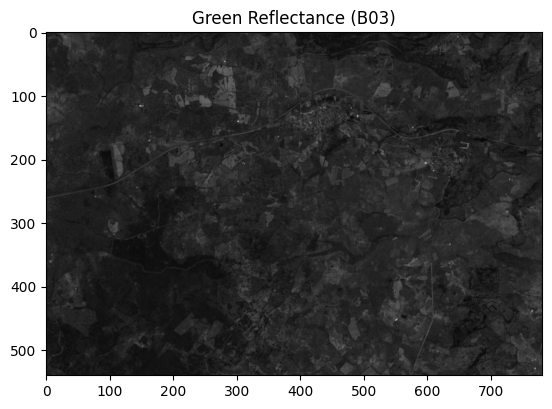

In [6]:
# Cloud mask using SCL
scl = data["SCL"].squeeze()
valid_mask = scl.isin([2, 4, 5, 6, 7, 11])

# Apply mask to bands
red = data["B04"].squeeze().where(valid_mask)
grn = data["B03"].squeeze().where(valid_mask)
blu = data["B02"].squeeze().where(valid_mask)

# Compute
red = red.compute()
grn = grn.compute()
blu = blu.compute()

# Visualize
plt.imshow(grn.values, cmap="gray")
plt.title("Green Reflectance (B03)")

As the EoPF toolkit explains:
> To create the composite image, we need to normalise each of the input assets. Normalisation ensures that the bands have a consistent and predictable range of values. This supports optimal data processing and removes the influence of external factors (like changing light conditions) allowing for a meaningful comparison among generated composites.
>
> The `normalisation_str_gm()` function achieves this by scaling the reflectance values to a standard range (0-255) using the percentile-based method.
>
> Once the values for our three bands have been normalised, they can be stacked in an RGB format to generate the initial True Colour Image (TCI).

Additionally, we're applying histogram equalization to adjust brightness and enhance visual contrast. This is done via the `exposure.equalize_hist()` function from the `skimage` library.

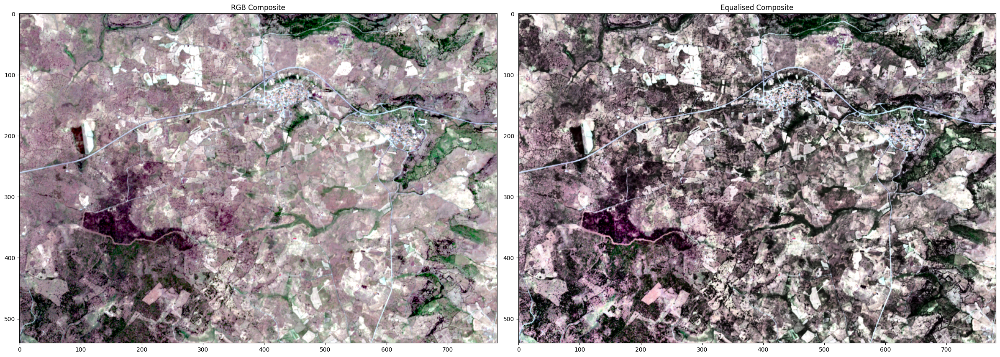

In [7]:
def normalisation_str_gm(
    band_array: npt.NDArray, p_min: float, p_max: float, gamma_val: float
) -> npt.NDArray:
    """
    Applies percentile-based contrast stretching and gamma correction to a band.

    Recieves:

    - band_array (xarray) : the extracted `xarray` for the selected band
    - p_min (int): percentile min value
    - p_max (int): percentile max value
    - gamma_val (int): gamma correction

    Returns:
    - 2d array with the normalised input values
    """

    # Calculate min and max values based on percentiles for stretching
    min_val = (
        np.percentile(band_array[band_array > 0], p_min)
        if np.any(band_array > 0)
        else 0
    )
    max_val = (
        np.percentile(band_array[band_array > 0], p_max)
        if np.any(band_array > 0)
        else 1
    )

    # Avoid division by zero if min_val equals max_val
    if max_val == min_val:
        stretched_band = np.zeros_like(band_array, dtype=np.float32)
    else:
        # Linear stretch to 0-1 range
        stretched_band = (band_array - min_val) / (max_val - min_val)

    # Clip values to ensure they are within [0, 1] after stretching
    stretched_band[stretched_band < 0] = 0
    stretched_band[stretched_band > 1] = 1

    # Apply gamma correction
    gamma_corrected_band = np.power(stretched_band, 1.0 / gamma_val)

    # Returns the corrected array:
    return gamma_corrected_band


# Normalize bands
contrast_stretch_percentile = (2, 98)
gamma = 1.8

red_processed = normalisation_str_gm(red.values, *contrast_stretch_percentile, gamma)
grn_processed = normalisation_str_gm(grn.values, *contrast_stretch_percentile, gamma)
blu_processed = normalisation_str_gm(blu.values, *contrast_stretch_percentile, gamma)

# Stack to RGB
rgb = np.dstack([red_processed, grn_processed, blu_processed]).astype(np.float32)

# Equalize
rgb_eq = exposure.equalize_adapthist(rgb)

# Plot side by side
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(rgb)
axes[0].set_title("RGB Composite")
axes[1].imshow(rgb_eq)
axes[1].set_title("Equalised Composite")
plt.tight_layout()

Next, we'll apply a false color composite to better visualize vegetation health. As mentioned during the lecture, different false color composites emphasize different features. Here, we're using shortwave infrared (B12), near-infrared (B8A), and blue (B02) bands, a combination that enhances the distinction between health vegetation (in green) and burned areas (in dark brown or black).

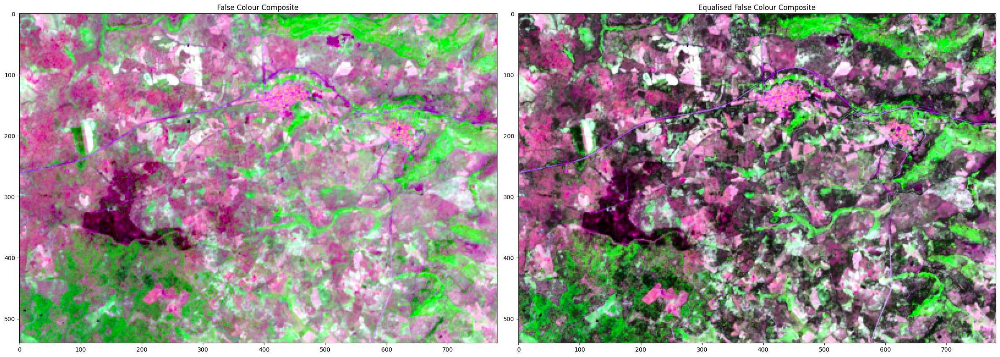

In [8]:
# False color composite (SWIR, NIR, Blue)
swir = data["B12"].squeeze().where(valid_mask).compute()
nir = data["B8A"].squeeze().where(valid_mask).compute()

# Normalize
swir_processed = normalisation_str_gm(swir.values, *contrast_stretch_percentile, gamma)
nir_processed = normalisation_str_gm(nir.values, *contrast_stretch_percentile, gamma)
blu_processed = normalisation_str_gm(blu.values, *contrast_stretch_percentile, gamma)

# Stack and equalize
false_rgb = np.dstack([swir_processed, nir_processed, blu_processed]).astype(np.float32)
false_rgb_eq = exposure.equalize_adapthist(false_rgb)

# Plot side by side
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(false_rgb)
axes[0].set_title("False Colour Composite")
axes[1].imshow(false_rgb_eq)
axes[1].set_title("Equalised False Colour Composite")
plt.tight_layout()

Post-fire items found: 1


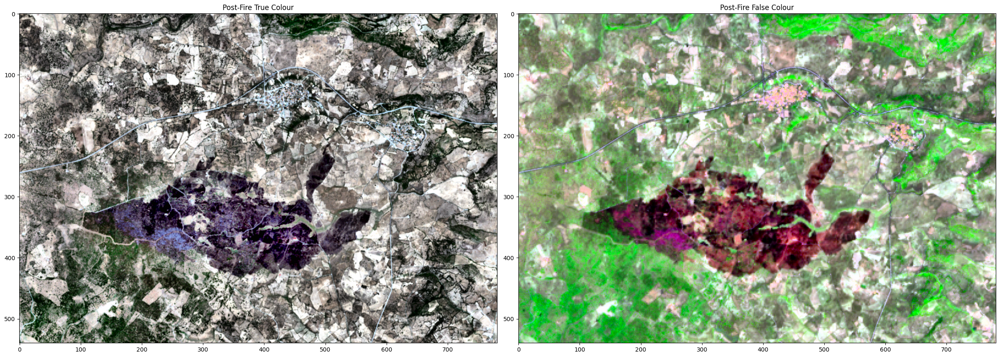

In [9]:
# Post-fire image
post_f = "2025-06-21"

post_items = list(
    catalog.search(
        bbox=search_bbox,
        datetime=f"{post_f}T00:00:00Z/{post_f}T23:59:59Z",
        collections="sentinel-2-l2a",
    ).item_collection()
)

print(f"Post-fire items found: {len(post_items)}")

# Load post-fire data
data_post = odc.stac.load(
    post_items,
    bands=["B04", "B03", "B02", "B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={},
)

# Cloud mask
scl_post = data_post["SCL"].squeeze()
valid_mask_post = scl_post.isin([2, 4, 5, 6, 7, 11])

# True color bands
red_post = data_post["B04"].squeeze().where(valid_mask_post).compute()
grn_post = data_post["B03"].squeeze().where(valid_mask_post).compute()
blu_post = data_post["B02"].squeeze().where(valid_mask_post).compute()

# False color bands
swir_post = data_post["B12"].squeeze().where(valid_mask_post).compute()
nir_post = data_post["B8A"].squeeze().where(valid_mask_post).compute()

# True color composite
red_proc = normalisation_str_gm(red_post.values, *contrast_stretch_percentile, gamma)
grn_proc = normalisation_str_gm(grn_post.values, *contrast_stretch_percentile, gamma)
blu_proc = normalisation_str_gm(blu_post.values, *contrast_stretch_percentile, gamma)
tc_post = np.dstack([red_proc, grn_proc, blu_proc]).astype(np.float32)
tc_post_eq = exposure.equalize_adapthist(tc_post)

# False color composite
swir_proc = normalisation_str_gm(swir_post.values, *contrast_stretch_percentile, gamma)
nir_proc = normalisation_str_gm(nir_post.values, *contrast_stretch_percentile, gamma)
fc_post = np.dstack([swir_proc, nir_proc, blu_proc]).astype(np.float32)
fc_post_eq = exposure.equalize_adapthist(fc_post)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
axes[0].imshow(tc_post_eq)
axes[0].set_title("Post-Fire True Colour")
axes[1].imshow(fc_post_eq)
axes[1].set_title("Post-Fire False Colour")
plt.tight_layout()

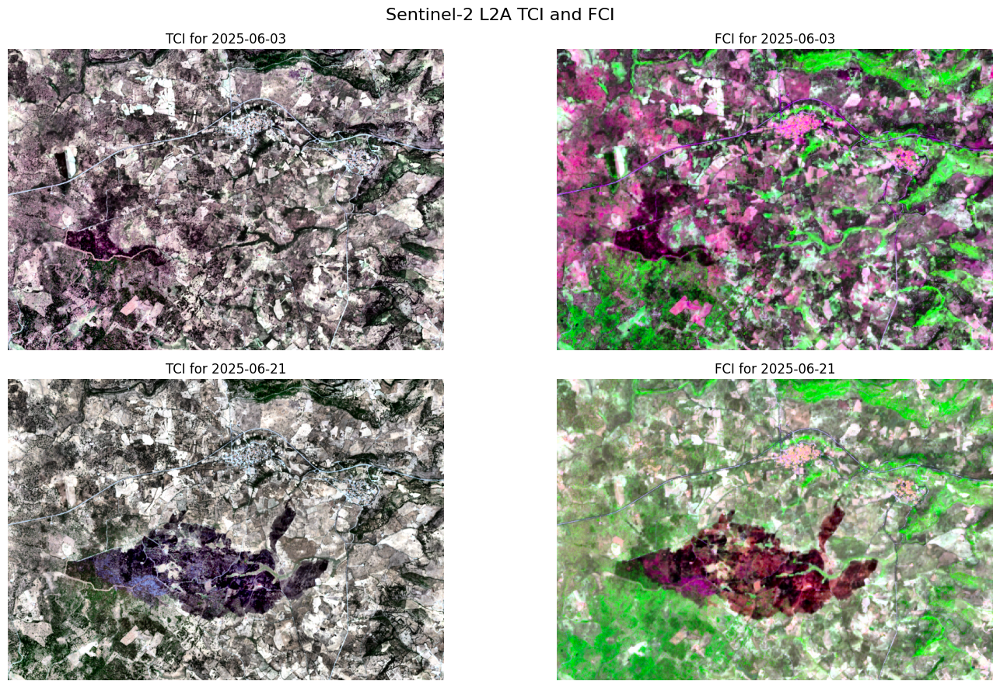

In [10]:
# Simplified visualization without geographic coordinates
fig, axs = plt.subplots(2, 2, figsize=(15, 9))

# Pre fire TCI
axs[0, 0].imshow(rgb_eq)
axs[0, 0].set_title(f"TCI for {pre_f}")
axs[0, 0].axis("off")

# Pre fire FCI
axs[0, 1].imshow(false_rgb_eq)
axs[0, 1].set_title(f"FCI for {pre_f}")
axs[0, 1].axis("off")

# Post fire TCI
axs[1, 0].imshow(tc_post_eq)
axs[1, 0].set_title(f"TCI for {post_f}")
axs[1, 0].axis("off")

# Post fire FCI
axs[1, 1].imshow(fc_post_eq)
axs[1, 1].set_title(f"FCI for {post_f}")
axs[1, 1].axis("off")

fig.suptitle("Sentinel-2 L2A TCI and FCI", fontsize=16)
plt.tight_layout()
plt.show()

For both the pre- and post-fire image, we're going to calculate the Normalized Burn Ratio (NBR), an index which is particularly useful for assessing fire severity. As we saw during the lecture, NBR is calculated as a ratio of the NIR and SWIR bands:

$$NBR = \frac{NIR - SWIR}{NIR + SWIR}$$

An NBR closer to 1 indicates healthy vegetation, while an NBR closer to -1 indicates burned or non-vegetated areas.

We can then take the _difference_ of the pre- and post-fire NBR, giving us the differenced Normalized Burn Ratio (dNBR). This index highlights the changes in vegetation health due to the fire, with higher positive values indicating more severe burn areas.

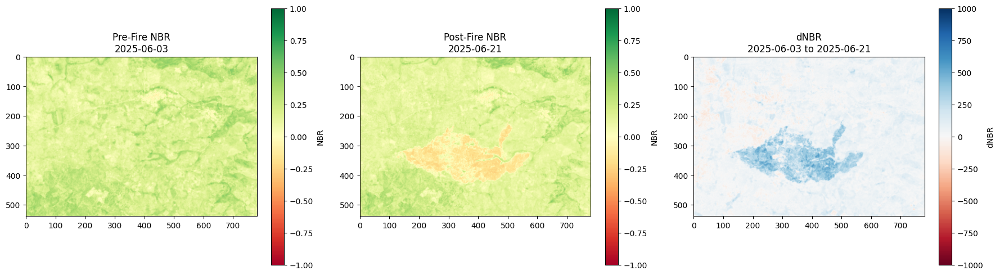

In [11]:
# NBR Calculation using Planetary Computer data
# Pre-fire NBR
nir_pre = data["B8A"].squeeze().where(valid_mask).compute()
swir_pre = data["B12"].squeeze().where(valid_mask).compute()

nir_pre_vals = nir_pre.values.astype(float)
swir_pre_vals = swir_pre.values.astype(float)

nbr_pre = np.where(
    (nir_pre_vals + swir_pre_vals) == 0,
    0,
    (nir_pre_vals - swir_pre_vals) / (nir_pre_vals + swir_pre_vals),
)

# Post-fire NBR
nir_post_vals = nir_post.values.astype(float)
swir_post_vals = swir_post.values.astype(float)

nbr_post = np.where(
    (nir_post_vals + swir_post_vals) == 0,
    0,
    (nir_post_vals - swir_post_vals) / (nir_post_vals + swir_post_vals),
)

# dNBR
dNBR = (nbr_pre - nbr_post) * 1000

# Consolidated visualization
fig, axs = plt.subplots(1, 3, figsize=(18, 5))

im0 = axs[0].imshow(nbr_pre, vmin=-1.0, vmax=1.0, cmap="RdYlGn")
axs[0].set_title(f"Pre-Fire NBR\n{pre_f}")
plt.colorbar(im0, ax=axs[0], label="NBR")

im1 = axs[1].imshow(nbr_post, vmin=-1.0, vmax=1.0, cmap="RdYlGn")
axs[1].set_title(f"Post-Fire NBR\n{post_f}")
plt.colorbar(im1, ax=axs[1], label="NBR")

im2 = axs[2].imshow(dNBR, vmin=-1000, vmax=1000, cmap="RdBu")
axs[2].set_title(f"dNBR\n{pre_f} to {post_f}")
plt.colorbar(im2, ax=axs[2], label="dNBR")

plt.tight_layout()
plt.show()

Looking at density plots of the NBR from the pre- and post-fire image, we can see emergence of a bimodal distribution in the post-fire NBR, as well as a meaningful drop in the average and 10th percentile NBR values, indicating a significant portion of the area has been affected by the fire.

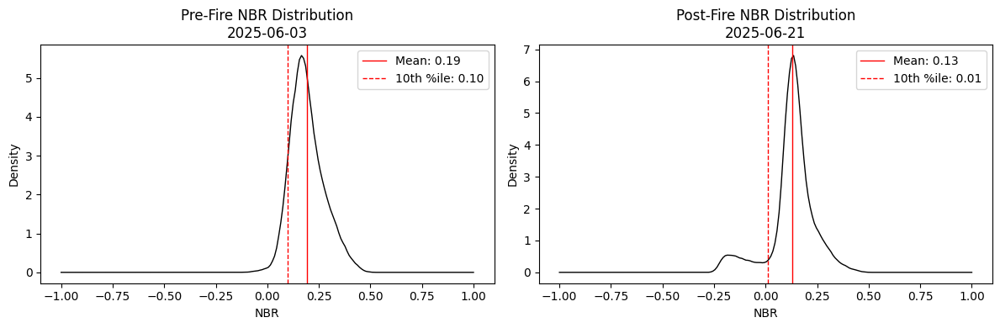

In [ ]:
# Pre- and Post-fire NBR Density Plots
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# Flatten and remove NaN values
nbr_pre_flat = nbr_pre.flatten()
nbr_pre_flat = nbr_pre_flat[~np.isnan(nbr_pre_flat)]

nbr_post_flat = nbr_post.flatten()
nbr_post_flat = nbr_post_flat[~np.isnan(nbr_post_flat)]

# Calculate statistics
pre_mean = np.mean(nbr_pre_flat)
pre_p10 = np.percentile(nbr_pre_flat, 10)
post_mean = np.mean(nbr_post_flat)
post_p10 = np.percentile(nbr_post_flat, 10)

# Create density estimates
x = np.linspace(-1, 1, 200)
kde_pre = gaussian_kde(nbr_pre_flat)
kde_post = gaussian_kde(nbr_post_flat)

axs[0].plot(x, kde_pre(x), color="black", linewidth=1)
axs[0].axvline(
    x=pre_mean, color="red", linestyle="-", linewidth=1, label=f"Mean: {pre_mean:.2f}"
)
axs[0].axvline(
    x=pre_p10,
    color="red",
    linestyle="--",
    linewidth=1,
    label=f"10th %ile: {pre_p10:.2f}",
)
axs[0].set_title(f"Pre-Fire NBR Distribution\n{pre_f}")
axs[0].set_xlabel("NBR")
axs[0].set_ylabel("Density")
axs[0].legend()

axs[1].plot(x, kde_post(x), color="black", linewidth=1)
axs[1].axvline(
    x=post_mean, color="red", linestyle="-", linewidth=1, label=f"Mean: {post_mean:.2f}"
)
axs[1].axvline(
    x=post_p10,
    color="red",
    linestyle="--",
    linewidth=1,
    label=f"10th %ile: {post_p10:.2f}",
)
axs[1].set_title(f"Post-Fire NBR Distribution\n{post_f}")
axs[1].set_xlabel("NBR")
axs[1].set_ylabel("Density")
axs[1].legend()

plt.tight_layout()
plt.show()

Next, we'll classify the dNBR values into burn severity categories ( a form of thresholding based on established scientific guidelines). 

| Class | dNBR range (×1000) |
|-------|-------------------|
| Unburned / Regrowth | < 100 |
| Low severity | 100–270 |
| Moderate-low severity | 270–440 |
| Moderate-high severity | 440–660 |
| High severity | ≥ 660 |

(Notice, by the way, that many of the "low severity" patches that appear in the image may be noise. Indices and thresholds like these are best used for general trends over larger areas, rather than pixel-perfect classification, and as we get further into the semester, we'll see how more advanced techniques can give us more accurate pixel-level results for various applications.)

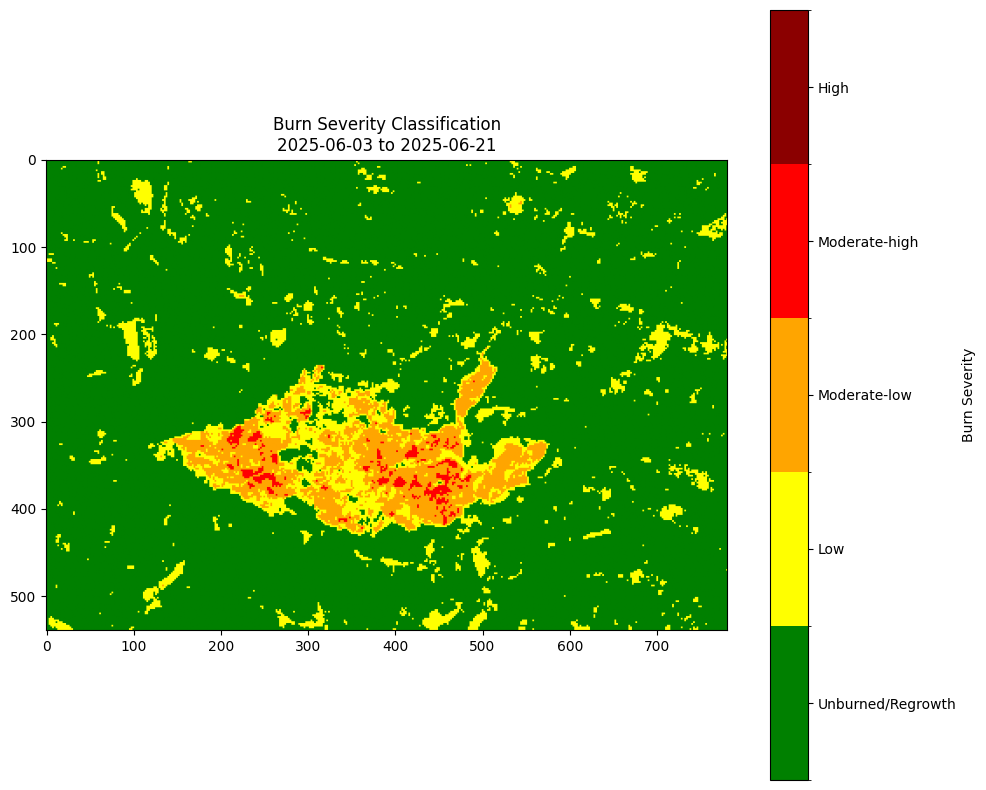

In [ ]:
# Classify dNBR into burn severity categories
burn_severity = np.zeros_like(dNBR)
burn_severity = np.where(dNBR < 100, 0, burn_severity)  # Unburned / Regrowth
burn_severity = np.where((dNBR >= 100) & (dNBR < 270), 1, burn_severity)  # Low severity
burn_severity = np.where(
    (dNBR >= 270) & (dNBR < 440), 2, burn_severity
)  # Moderate-low severity
burn_severity = np.where(
    (dNBR >= 440) & (dNBR < 660), 3, burn_severity
)  # Moderate-high severity
burn_severity = np.where(dNBR >= 660, 4, burn_severity)  # High severity

colors = ["green", "yellow", "orange", "red", "darkred"]
cmap = ListedColormap(colors)
bounds = [-0.5, 0.5, 1.5, 2.5, 3.5, 4.5]
norm = BoundaryNorm(bounds, cmap.N)

# Visualization
fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(burn_severity, cmap=cmap, norm=norm)

cbar = plt.colorbar(im, ax=ax, ticks=[0, 1, 2, 3, 4])
cbar.ax.set_yticklabels(
    ["Unburned/Regrowth", "Low", "Moderate-low", "Moderate-high", "High"]
)
cbar.set_label("Burn Severity")

ax.set_title(f"Burn Severity Classification\n{pre_f} to {post_f}")
plt.tight_layout()
plt.show()

Finally, we'll look at weekly composites of NBR derived from Sentinel-2 imagery before and after the fire. A number of things stand out here. We can definitely see the fire scar appear in the week following the fire, and persist for many weeks after that. It's interesting to notice that the scar appears stronger in the composite two weeks after the fire, perhaps a result of the composite for June 15th combining an image from before the fire and after the fire. Another interesting trend is that this fire took place in mid-summer, and we can see the NBR values gradually declining over the following weeks, likely due to seasonal drying of vegetation in the Mediterranean summer. This highlights the importance of anomaly detection; a more sophisticated analysis could attempt to separate out seasonal trends from fire-related changes, although that would be overkill for our purposes. Lastly, note the impact of cloud cover, which obcures significant portions of a number of these composites.

Found 36 items


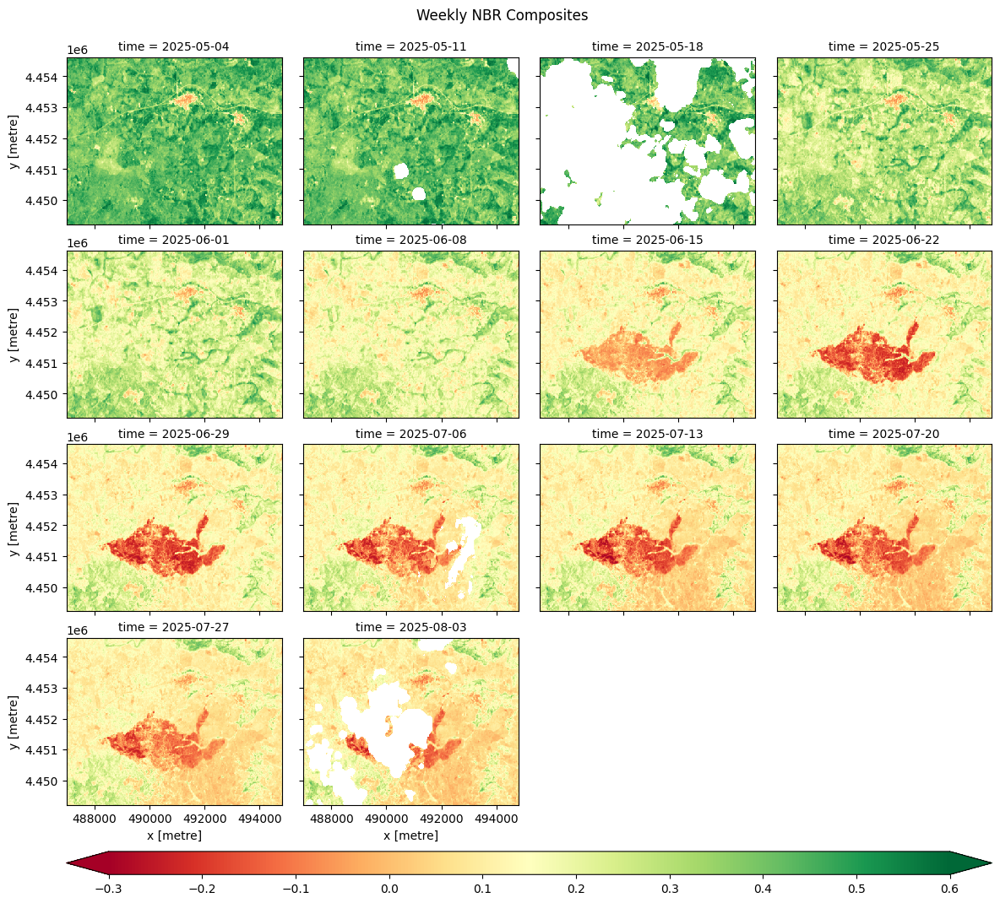

In [14]:
items = list(
    catalog.search(
        bbox=search_bbox,
        datetime="2025-05-01/2025-07-30",
        collections="sentinel-2-l2a",
        query={"eo:cloud_cover": {"lt": 30}},
    ).item_collection()
)

print(f"Found {len(items)} items")

# Load all scenes
data_ts = odc.stac.load(
    items,
    bands=["B8A", "B12", "SCL"],
    bbox=search_bbox,
    chunks={"time": 1},
)


# Calculate NBR for each timestep
def calc_nbr(nir, swir):
    nir = nir.astype(float)
    swir = swir.astype(float)
    return (nir - swir) / (nir + swir + 1e-10)


nbr_ts = calc_nbr(data_ts["B8A"], data_ts["B12"])

# Mask clouds
scl = data_ts["SCL"]
valid = scl.isin([2, 4, 5, 6, 7, 11])
nbr_ts = nbr_ts.where(valid)

# weekly composites
nbr_biweekly = nbr_ts.resample(time="1W").mean().compute()

# Compute mean NBR per weekly period within AOI
nbr_mean_biweekly = nbr_biweekly.mean(dim=["x", "y"])

# Maps with tighter range
g = nbr_biweekly.plot.imshow(
    col="time",
    col_wrap=4,
    vmin=-0.3,
    vmax=0.6,
    cmap="RdYlGn",
    figsize=(12, 12),
    cbar_kwargs={"orientation": "horizontal", "pad": 0.05, "aspect": 40},
)
plt.suptitle("Weekly NBR Composites", y=1.02)
plt.show()